# Import Packages

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
os.environ['USE_PYGEOS'] = '0'
import geopandas as gpd
import seaborn as sns
import folium

# For geocoding
from geopy.geocoders import Nominatim

import requests
from requests import get

# Import Distribution Substation data from CSV

In [152]:
ds = pd.read_csv('../../data/network_data/distribution_substations.csv')
ds.head()

/var/folders/3p/gfh9bx_x6g538359fqt4lgtm0000gn/T/ipykernel_4179/3297352422.py:1: DtypeWarning: Columns (19,20,21,22,23,24,25,26,27,28,29,30,31,32,33) have mixed types. Specify dtype option on import or set low_memory=False.
  ds = pd.read_csv('../../data/network_data/distribution_substations.csv')


,index,License Area,Grid Supply Point Number,Grid Supply Point Name,Bulk Supply Point Number,Bulk Supply Point Name,Primary Name,Primary Number,HV Feeder,Substation Type,...,Total Generation Capacity,Solar,Wind,Bio Fuels,Water Generation,Waste Generation,Storage Generation,Fossil Fuels,Other Generation,Customers
0,0,South West,306004,Abham S.G.P.,330006,Plympton Bsp,Linketty Lane,330029,330029/0016,Grd Mtd,...,14.26,4,0,0,0,0,0,0,0,115
1,1,South West,306004,Abham S.G.P.,330003,Plymouth Bsp,Plymstock South,330037,330037/0017,Grd Mtd,...,7.45,2,0,0,0,0,0,0,0,59
2,2,South West,306004,Abham S.G.P.,330003,Plymouth Bsp,Plymstock South,330037,330037/0018,Grd Mtd,...,24.41,7,0,0,0,0,0,0,0,149
3,4,South West,306004,Abham S.G.P.,330006,Plympton Bsp,Linketty Lane,330029,330029/0016,Grd Mtd,...,236.04,75,0,0,0,0,0,0,0,178
4,5,South West,406003,Landulph S.G.P.,330001,Ernesettle Bsp,Southway,330023,330023/0046,Grd Mtd,...,47.5,2,0,0,0,0,0,0,0,27


In [153]:
ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 186011 entries, 0 to 186010
Data columns (total 34 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   index                      186011 non-null  int64  
 1   License Area               186011 non-null  object 
 2   Grid Supply Point Number   186011 non-null  int64  
 3   Grid Supply Point Name     186011 non-null  object 
 4   Bulk Supply Point Number   186011 non-null  int64  
 5   Bulk Supply Point Name     186011 non-null  object 
 6   Primary Name               186011 non-null  object 
 7   Primary Number             186011 non-null  int64  
 8   HV Feeder                  184938 non-null  object 
 9   Substation Type            184938 non-null  object 
 10  Substation Name            186011 non-null  object 
 11  Substation Number          184938 non-null  float64
 12  Grid Reference             184938 non-null  object 
 13  LONGITUDE                  18

### Cleaning

In [160]:
ds = ds.replace('Hidden', np.nan)

In [161]:
ds['EV Chargers'] = ds['EV Chargers'].astype('float64')
ds['Heat Pumps'] = ds['Heat Pumps'].astype('float64')
ds['Customers'] = ds['Customers'].astype('float64')

ds['Substation Number'] = ds['Substation Number'].astype('Int64').astype(str)

In [162]:
ds[ds['Bulk Supply Point Name'].str.contains('Bath', regex=False)]['Primary Name'].value_counts()

Batheaston             175
Entry Hill             124
Dorchester St - New    122
Combe Park              84
Twerton                 60
Oldfield Park           53
Park Street             45
Name: Primary Name, dtype: int64

# Load Distribution Substation Shapefiles

In [128]:
file = '../../data/network_data/dist_swest_march2023.gpkg'
ds_geo = gpd.read_file(file)
# ds_geo = ds_geo.set_index('NR', drop=False) # Set index to the distribution substation number (NR)
ds_geo.head()

,NRID,NR,NR_TYPE_ID,NAME,PRIM_NRID,PRIM_NRID_NAME,BSP_NRID,BSP_NRID_NAME,GSP_NRID,GSP_NRID_NAME,geometry
0,48064,182064,19,Norville Lane,15094,Cheddar,85,Churchill Bsp 132kv,135,Bridgwater S.G.P.,"MULTIPOLYGON (((345680.766 153442.467, 345687...."
1,48064,182064,19,Norville Lane,15094,Cheddar,85,Churchill Bsp 132kv,135,Bridgwater S.G.P.,"MULTIPOLYGON (((345851.254 153358.728, 345838...."
2,48064,182064,19,Norville Lane,15094,Cheddar,85,Churchill Bsp 132kv,135,Bridgwater S.G.P.,"MULTIPOLYGON (((345866.521 153634.380, 345876...."
3,45824,180819,19,Wideatts Rd,15094,Cheddar,85,Churchill Bsp 132kv,135,Bridgwater S.G.P.,"MULTIPOLYGON (((345111.495 153410.786, 345106...."
4,47236,181591,19,Barrows Park,15094,Cheddar,85,Churchill Bsp 132kv,135,Bridgwater S.G.P.,"MULTIPOLYGON (((345315.659 153581.623, 345314...."


In [129]:
ds_geo.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 60512 entries, 0 to 60511
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   NRID            60512 non-null  int64   
 1   NR              60512 non-null  object  
 2   NR_TYPE_ID      60512 non-null  int64   
 3   NAME            58199 non-null  object  
 4   PRIM_NRID       60512 non-null  int64   
 5   PRIM_NRID_NAME  60445 non-null  object  
 6   BSP_NRID        60512 non-null  int64   
 7   BSP_NRID_NAME   60510 non-null  object  
 8   GSP_NRID        60512 non-null  int64   
 9   GSP_NRID_NAME   60510 non-null  object  
 10  geometry        60512 non-null  geometry
dtypes: geometry(1), int64(5), object(5)
memory usage: 5.1+ MB


In [130]:
ds_geo = ds_geo.rename(columns={'NR':'Substation Number'})

## Dissolve duplate columns (with different geometries)

In [131]:
ds_geo = ds_geo.dissolve('Substation Number').reset_index()

In [132]:
ds_geo.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 53531 entries, 0 to 53530
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   Substation Number  53531 non-null  object  
 1   geometry           53531 non-null  geometry
 2   NRID               53531 non-null  int64   
 3   NR_TYPE_ID         53531 non-null  int64   
 4   NAME               51365 non-null  object  
 5   PRIM_NRID          53531 non-null  int64   
 6   PRIM_NRID_NAME     53465 non-null  object  
 7   BSP_NRID           53531 non-null  int64   
 8   BSP_NRID_NAME      53529 non-null  object  
 9   GSP_NRID           53531 non-null  int64   
 10  GSP_NRID_NAME      53529 non-null  object  
dtypes: geometry(1), int64(5), object(5)
memory usage: 4.5+ MB


<Axes: >

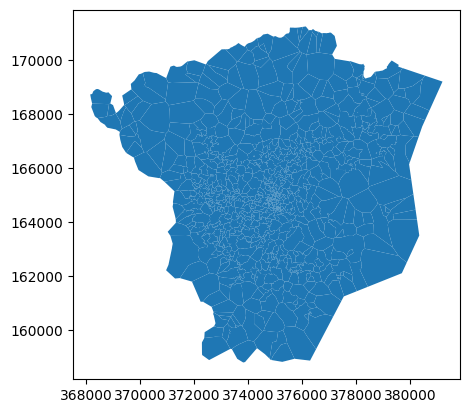

In [133]:
ds_geo[ds_geo.GSP_NRID == 131].plot()

# Merge Datasets

In [164]:
ds_combined = pd.merge(ds_geo, ds, how='left', on ='Substation Number')
ds_combined.head()

,Substation Number,geometry,NRID,NR_TYPE_ID,NAME,PRIM_NRID,PRIM_NRID_NAME,BSP_NRID,BSP_NRID_NAME,GSP_NRID,...,Total Generation Capacity,Solar,Wind,Bio Fuels,Water Generation,Waste Generation,Storage Generation,Fossil Fuels,Other Generation,Customers
0,110001,"MULTIPOLYGON (((359415.517 174908.040, 359409....",33447,19,Chesterfield Rd Id,15039,St Pauls Bsp 11kv,104,St Pauls Bsp 132kv,130,...,29.22,11,0,0,0,0,0,0,0,367.0
1,110002,"MULTIPOLYGON (((359114.040 174783.416, 359096....",33449,19,Effingham Road Id,15039,St Pauls Bsp 11kv,104,St Pauls Bsp 132kv,130,...,16.99,7,0,0,0,0,0,0,0,331.0
2,110003,"POLYGON ((359010.628 175188.146, 359011.850 17...",33451,19,Somerville Rd,15039,St Pauls Bsp 11kv,104,St Pauls Bsp 132kv,130,...,54.535,15,0,0,0,0,1,0,0,254.0
3,110003,"POLYGON ((359010.628 175188.146, 359011.850 17...",33451,19,Somerville Rd,15039,St Pauls Bsp 11kv,104,St Pauls Bsp 132kv,130,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,110004,"MULTIPOLYGON (((359191.503 175402.490, 359193....",33453,19,Kent Road P,15039,St Pauls Bsp 11kv,104,St Pauls Bsp 132kv,130,...,26.115,10,0,0,0,0,0,0,0,276.0


In [165]:
ds_combined = ds_combined.rename(columns={'Substation Name':'Name'})
ds_combined.loc[ds_combined['Name'].isna(), 'Name'] = 'Name Unknown' # For the "key_on" part of the choropleth map

In [166]:
bath_ds_combined = ds_combined[ds_combined['GSP_NRID'] == 131]
bath_ds_combined.head()

,Substation Number,geometry,NRID,NR_TYPE_ID,NAME,PRIM_NRID,PRIM_NRID_NAME,BSP_NRID,BSP_NRID_NAME,GSP_NRID,...,Total Generation Capacity,Solar,Wind,Bio Fuels,Water Generation,Waste Generation,Storage Generation,Fossil Fuels,Other Generation,Customers
798,111229,"POLYGON ((368159.983 168719.998, 368169.060 16...",35200,18,Avon Farm,15080,Combe Park,94,Bath (Dolemeads) 132,131,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
799,111230,"POLYGON ((368420.060 167844.820, 368370.921 16...",35202,18,Avon Cottage,15080,Combe Park,94,Bath (Dolemeads) 132,131,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
824,111259,"POLYGON ((369337.334 167913.995, 369276.539 16...",35254,18,Jolly Sailor,15080,Combe Park,94,Bath (Dolemeads) 132,131,...,2.62,1,0,0,0,0,0,0,0,15.0
827,111263,"POLYGON ((368927.158 167459.977, 368797.384 16...",35260,18,Mead Lane,15080,Combe Park,94,Bath (Dolemeads) 132,131,...,3.0,1,0,0,0,0,0,0,0,16.0
3327,160001,"POLYGON ((372337.346 165252.671, 372327.017 16...",39252,19,Apsley Road Rmua,15066,Twerton,94,Bath (Dolemeads) 132,131,...,19.64,5,0,0,0,0,0,0,0,133.0


In [167]:
bath_ds_combined.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 669 entries, 798 to 5946
Data columns (total 44 columns):
 #   Column                     Non-Null Count  Dtype   
---  ------                     --------------  -----   
 0   Substation Number          669 non-null    object  
 1   geometry                   669 non-null    geometry
 2   NRID                       669 non-null    int64   
 3   NR_TYPE_ID                 669 non-null    int64   
 4   NAME                       642 non-null    object  
 5   PRIM_NRID                  669 non-null    int64   
 6   PRIM_NRID_NAME             669 non-null    object  
 7   BSP_NRID                   669 non-null    int64   
 8   BSP_NRID_NAME              669 non-null    object  
 9   GSP_NRID                   669 non-null    int64   
 10  GSP_NRID_NAME              669 non-null    object  
 11  index                      645 non-null    float64 
 12  License Area               645 non-null    object  
 13  Grid Supply Point Number

In [168]:
bath_ds_combined.columns

Index(['Substation Number', 'geometry', 'NRID', 'NR_TYPE_ID', 'NAME',
       'PRIM_NRID', 'PRIM_NRID_NAME', 'BSP_NRID', 'BSP_NRID_NAME', 'GSP_NRID',
       'GSP_NRID_NAME', 'index', 'License Area', 'Grid Supply Point Number',
       'Grid Supply Point Name', 'Bulk Supply Point Number',
       'Bulk Supply Point Name', 'Primary Name', 'Primary Number', 'HV Feeder',
       'Substation Type', 'Name', 'Grid Reference', 'LONGITUDE', 'LATITUDE',
       'Day Max Demand', 'Night Max Demand', 'Substation Rating',
       'Transformer Headroom', 'LCT Count Total', 'Energy Storage',
       'Heat Pumps', 'EV Chargers', 'Total LCT Capacity',
       'Total Generation Capacity', 'Solar', 'Wind', 'Bio Fuels',
       'Water Generation', 'Waste Generation', 'Storage Generation',
       'Fossil Fuels', 'Other Generation', 'Customers'],
      dtype='object')

# Plot on map

In [169]:
address = "BA1 1LZ" # Chosen as a central location of Bath city

geolocator = Nominatim(user_agent="iyzf20@bath.ac.uk") # Using the Nominatim geolocator from OpenStreetMap

location = geolocator.geocode(address)

loc_lat = location.point.latitude
loc_lon = location.point.longitude

print("Latitude:", loc_lat)
print("Longitude:", loc_lon)

Latitude: 51.38100816666667
Longitude: -2.359801216666667


### Number of Customers

In [170]:
m1 = folium.Map(location=[loc_lat, loc_lon], tiles='openstreetmap', zoom_start=13)

cp = folium.Choropleth(geo_data = bath_ds_combined,
                       data = bath_ds_combined,
                       columns = ['Name', 'Customers'],
                       key_on = 'feature.properties.Name',
                       fill_color = "Blues",
                       fill_opacity = 0.7,
                       nan_fill_opacity = 0.5,
                       highlight=True).add_to(m1)
folium.GeoJsonTooltip(['Substation Number', 'Name', 'EV Chargers', 'Heat Pumps', 'Customers', 'Substation Rating', 'Day Max Demand']).add_to(cp.geojson)
folium.LayerControl().add_to(m1)
m1

### EV Charger Installations

In [171]:
m2 = folium.Map(location=[loc_lat, loc_lon], tiles='openstreetmap', zoom_start=13)

cp = folium.Choropleth(geo_data = bath_ds_combined,
                       data = bath_ds_combined,
                       columns = ['Name', 'EV Chargers'],
                       key_on = 'feature.properties.Name',
                       fill_color = "Blues",
                       fill_opacity = 0.7,
                       nan_fill_opacity = 0.5,
                       highlight=True).add_to(m2)
folium.GeoJsonTooltip(['Substation Number', 'Name', 'EV Chargers', 'Heat Pumps', 'Customers', 'Substation Rating', 'Day Max Demand']).add_to(cp.geojson)
folium.LayerControl().add_to(m2)
m2

### Day Max Demand

In [172]:
m3 = folium.Map(location=[loc_lat, loc_lon], tiles='openstreetmap', zoom_start=13)

cp = folium.Choropleth(geo_data = bath_ds_combined,
                       data = bath_ds_combined,
                       columns = ['Name', 'Day Max Demand'],
                       key_on = 'feature.properties.Name',
                       fill_color = "Reds",
                       fill_opacity = 0.7,
                       nan_fill_opacity = 0.5,
                       highlight=True).add_to(m3)
folium.GeoJsonTooltip(['Substation Number', 'Name', 'EV Chargers', 'Heat Pumps', 'Customers', 'Substation Rating', 'Day Max Demand']).add_to(cp.geojson)
folium.LayerControl().add_to(m3)
m3

## Capacity Utilisation

In [292]:
bath_ds_combined.loc[:, 'Utilisation'] = bath_ds_combined.loc[:, 'Day Max Demand'] / bath_ds_combined.loc[:, 'Substation Rating']
bath_ds_combined.Utilisation

/var/folders/3p/gfh9bx_x6g538359fqt4lgtm0000gn/T/ipykernel_4179/2576316867.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



798     0.84000
799     0.43750
824     0.00000
827     0.62000
3327    0.68254
         ...   
5932    0.11000
5933        NaN
5938        NaN
5940        NaN
5946    0.25200
Name: Utilisation, Length: 669, dtype: float64

In [293]:
m4 = folium.Map(location=[loc_lat, loc_lon], tiles='openstreetmap', zoom_start=13)

cp = folium.Choropleth(geo_data = bath_ds_combined,
                       data = bath_ds_combined,
                       columns = ['Name', 'Utilisation'],
                       key_on = 'feature.properties.Name',
                       fill_color = "Reds",
                       fill_opacity = 0.7,
                       nan_fill_opacity = 0.5,
                       highlight=True).add_to(m4)
folium.GeoJsonTooltip(['Substation Number', 'Name', 'EV Chargers', 'Heat Pumps', 'Customers', 'Substation Rating', 'Day Max Demand', 'Utilisation']).add_to(cp.geojson)
folium.LayerControl().add_to(m4)
m4

# Filters

Population Growth, Personal vehicle ownership, EV penetration, access to residential charger

### Messing about

In [ ]:
pg = 1.05 # Annual population growth
pvo = 0.7 # Personal vehicle ownership
ev_pen = 0.03 # EV penetration
rca = 0.9 # Access to residential chargers

In [ ]:
pop = 100 # population of 100 people

In [ ]:
years = 0

In [ ]:
n_ev_res = pop * (pg**years) * pvo * ev_pen * rca
n_ev_res

In [ ]:
n_ev_res = (bath_ds_combined.Customers * pg**years * pvo * ev_pen * rca).round().astype('Int64')
n_ev_res

In [ ]:
n_ev_res.sum()

# UK and BNES EV adoption analysis

### Read in .ods data for vehicle registration at UK level, regional level and upper/lower tier local authority level

Need to install odfpy (`pip install odfpy`)

In [ ]:
veh0105 = pd.read_excel("../../data/vehicle_data/veh0105.ods", engine="odf", sheet_name='VEH0105', skiprows=4)
veh0105.head()

In [ ]:
veh0142 = pd.read_excel("../../data/vehicle_data/veh0142.ods", engine="odf", sheet_name='VEH0142', skiprows=4)
veh0142.head()

### Replace [x] and [c] with np.nan

In [ ]:
veh0105 = veh0105.replace('[x]', np.nan)
veh0105 = veh0105.replace('[c]', np.nan)

In [ ]:
veh0142 = veh0142.replace('[x]', np.nan)
veh0142 = veh0142.replace('[c]', np.nan)

### Stip leading white Space

In [ ]:
veh0105['ONS Geography [note 6]'] = veh0105.apply(lambda x: x['ONS Geography [note 6]'].lstrip(), axis=1)

In [ ]:
veh0142['ONS Geography [note 6]'] = veh0142.apply(lambda x: x['ONS Geography [note 6]'].lstrip(), axis=1)

### Set index to Geography

In [ ]:
veh0105 = veh0105.set_index('ONS Geography [note 6]')

In [ ]:
veh0142 = veh0142.set_index('ONS Geography [note 6]')

In [ ]:
locations = [
    'Great Britain',
    # 'North East',
    # 'North West',
    # 'Yorkshire and The Humber',
    # 'East Midlands',
    # 'West Midlands',
    # 'East',
    'London',
    'South West',
    'South East',
    'Wales',
    'Scotland',
    'Northern Ireland',
    'Bath and North East Somerset'
]

In [ ]:
drop_cols_veh0105 = ['Units',
             'BodyType',
             'Fuel [note 2]',
             'Keepership [note 3]',
             'ONS Sort [note 6]',
             'ONS Code [note 6]',
]

veh0105[(veh0105['BodyType'] == 'Cars') & (veh0105['Fuel [note 2]'] == 'Total') & (veh0105['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0105, axis=1).loc[locations]

In [ ]:
(veh0105[(veh0105['BodyType'] == 'Cars') & (veh0105['Fuel [note 2]'] == 'Total') & (veh0105['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0105, axis=1).loc[locations].astype(float) * 1000).T.iloc[::-1].plot()

## BEVs

In [ ]:
drop_cols_veh0142 = [
    'Units',
    'BodyType',
    'Fuel',
    'Keepership [note 3]',
    'ONS Sort [note 6]',
    'ONS Code [note 6]',
]

veh0142[(veh0142['BodyType'] == 'Cars') & (veh0142['Fuel'] == 'Battery electric') & (veh0142['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0142, axis=1).loc[locations]

In [ ]:
veh0142[(veh0142['BodyType'] == 'Cars') & (veh0142['Fuel'] == 'Battery electric') & (veh0142['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0142, axis=1).loc[locations].T.iloc[::-1].plot()

### BEV Penetration

In [ ]:
bev_pen = veh0142[(veh0142['BodyType'] == 'Cars') & (veh0142['Fuel'] == 'Battery electric') & (veh0142['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0142, axis=1).loc[locations].divide(
    (veh0105[(veh0105['BodyType'] == 'Cars') & (veh0105['Fuel [note 2]'] == 'Total') & (veh0105['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0105, axis=1).loc[locations] * 1000)
)
bev_pen.T.iloc[::-1].plot()
plt.title('BEV Penetration by Region')

### PHEV (Petrol) Penetration

In [ ]:
phev_pet_pen = veh0142[(veh0142['BodyType'] == 'Cars') & (veh0142['Fuel'] == 'Plug-in hybrid electric (petrol)') & (veh0142['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0142, axis=1).loc[locations].divide(
    (veh0105[(veh0105['BodyType'] == 'Cars') & (veh0105['Fuel [note 2]'] == 'Total') & (veh0105['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0105, axis=1).loc[locations] * 1000)
)
phev_pet_pen.T.iloc[::-1].plot()
plt.title('PHEV (Petrol) Penetration by Region')

### PHEV (Diesel) Penetration

In [ ]:
phev_dies_pen = veh0142[(veh0142['BodyType'] == 'Cars') & (veh0142['Fuel'] == 'Plug-in hybrid electric (diesel)') & (veh0142['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0142, axis=1).loc[locations].divide(
    (veh0105[(veh0105['BodyType'] == 'Cars') & (veh0105['Fuel [note 2]'] == 'Total') & (veh0105['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0105, axis=1).loc[locations] * 1000)
)
phev_dies_pen.T.iloc[::-1].plot()
plt.title('PHEV (Diesel) Penetration by Region')

### EV Penetration

In [ ]:
ev_pen = veh0142[(veh0142['BodyType'] == 'Cars') & (veh0142['Fuel'] == 'Total') & (veh0142['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0142, axis=1).loc[locations].divide(
    (veh0105[(veh0105['BodyType'] == 'Cars') & (veh0105['Fuel [note 2]'] == 'Total') & (veh0105['Keepership [note 3]'] == 'Private')].drop(drop_cols_veh0105, axis=1).loc[locations] * 1000)
)
ev_pen.T.iloc[::-1].plot()
plt.title('EV Penetration by Region')

# LSOAs

### EV LSOA Registration Data

In [71]:
ev_lsoa = pd.read_csv('../../data/vehicle_data/df_VEH0145.csv')
ev_lsoa.head()

/var/folders/3p/gfh9bx_x6g538359fqt4lgtm0000gn/T/ipykernel_4179/3986163220.py:1: DtypeWarning: Columns (45,46,47) have mixed types. Specify dtype option on import or set low_memory=False.
  ev_lsoa = pd.read_csv('../../data/vehicle_data/df_VEH0145.csv')


,LSOA11CD,LSOA11NM,Fuel,Keepership,2022 Q3,2022 Q2,2022 Q1,2021 Q4,2021 Q3,2021 Q2,...,2014 Q1,2013 Q4,2013 Q3,2013 Q2,2013 Q1,2012 Q4,2012 Q3,2012 Q2,2012 Q1,2011 Q4
0,95AA01S1,Aldergrove 1,Battery electric,Company,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,95AA01S2,Aldergrove 2,Battery electric,Company,[c],[c],[c],[c],[c],[c],...,0,0,0,0,0,0,0,0,0,0
2,95AA01S3,Aldergrove 3,Battery electric,Company,[c],0,0,0,0,0,...,[c],0,0,0,0,0,0,0,0,0
3,95AA02W1,Balloo,Battery electric,Company,[c],[c],[c],[c],[c],[c],...,0,0,0,0,0,0,0,0,0,0
4,95AA04W1,Clady,Battery electric,Company,[c],5,[c],[c],[c],[c],...,0,0,0,0,0,0,0,0,0,0


In [72]:
ev_lsoa = ev_lsoa[ev_lsoa['Keepership'] == 'Private']

In [73]:
ev_lsoa = ev_lsoa.replace('[c]', np.nan)

Convert from string to numeric

In [74]:
cols = ev_lsoa.columns.drop(['LSOA11CD', 'LSOA11NM', 'Fuel', 'Keepership'])
ev_lsoa[cols] = ev_lsoa[cols].apply(pd.to_numeric)

### LSOA Spatial Data

In [75]:
lsoa_geo = gpd.read_file('../../data/spatial_data/lsoa_data/Lower_Layer_Super_Output_Areas__December_2011__Boundaries_Full_Clipped__BFC__EW_V3.shp')
lsoa_geo.head()

,OBJECTID,LSOA11CD,LSOA11NM,BNG_E,BNG_N,LONG_,LAT,Shape_Leng,Shape__Are,Shape__Len,geometry
0,1,E01000001,City of London 001A,532123,181632,-0.097140,51.5182,2635.767993,129865.314354,2635.767993,"POLYGON ((532151.537 181867.433, 532152.500 18..."
1,2,E01000002,City of London 001B,532480,181715,-0.091970,51.5188,2707.881853,228419.634727,2707.881853,"POLYGON ((532634.497 181926.016, 532632.048 18..."
2,3,E01000003,City of London 001C,532239,182033,-0.095320,51.5217,1224.638192,59054.351929,1224.638192,"POLYGON ((532153.703 182165.155, 532158.250 18..."
3,4,E01000005,City of London 001E,533581,181283,-0.076270,51.5147,2275.805348,189577.710655,2275.805348,"POLYGON ((533619.062 181402.364, 533639.868 18..."
4,5,E01000006,Barking and Dagenham 016A,544994,184274,0.089317,51.5387,1966.092607,146536.995750,1966.092607,"POLYGON ((545126.852 184310.838, 545145.213 18..."


In [76]:
lsoa_geo.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 34753 entries, 0 to 34752
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   OBJECTID    34753 non-null  int64   
 1   LSOA11CD    34753 non-null  object  
 2   LSOA11NM    34753 non-null  object  
 3   BNG_E       34753 non-null  int64   
 4   BNG_N       34753 non-null  int64   
 5   LONG_       34753 non-null  float64 
 6   LAT         34753 non-null  float64 
 7   Shape_Leng  34753 non-null  float64 
 8   Shape__Are  34753 non-null  float64 
 9   Shape__Len  34753 non-null  float64 
 10  geometry    34753 non-null  geometry
dtypes: float64(5), geometry(1), int64(3), object(2)
memory usage: 2.9+ MB


Merge LSOA Data

In [78]:
ev_lsoa_geo = pd.merge(lsoa_geo.loc[:, ['LSOA11CD', 'geometry']], ev_lsoa, on='LSOA11CD', how='outer')

### LSOA Lookup Data

In [79]:
lsoa_lookup = pd.read_csv('../../data/spatial_data/lsoa_data/LSOA_(2011)_to_LSOA_(2021)_to_Local_Authority_District_(2022)_Lookup_for_England_and_Wales_(Version_2).csv')
lsoa_lookup.head()

,LSOA11CD,LSOA11NM,LSOA21CD,LSOA21NM,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId
0,E01000001,City of London 001A,E01000001,City of London 001A,U,E09000001,City of London,NaN,1
1,E01000002,City of London 001B,E01000002,City of London 001B,U,E09000001,City of London,NaN,2
2,E01000003,City of London 001C,E01000003,City of London 001C,U,E09000001,City of London,NaN,3
3,E01000005,City of London 001E,E01000005,City of London 001E,U,E09000001,City of London,NaN,4
4,E01000006,Barking and Dagenham 016A,E01000006,Barking and Dagenham 016A,U,E09000002,Barking and Dagenham,NaN,5


Filter for BNES LSOAs

In [80]:
lsoa_lookup[lsoa_lookup['LAD22NM'] == 'Bath and North East Somerset'].LSOA11CD

13651    E01014373
13652    E01014428
13676    E01014479
13678    E01014429
13681    E01014374
           ...    
33239    E01014402
33240    E01014475
33241    E01014475
33242    E01014379
33243    E01014379
Name: LSOA11CD, Length: 118, dtype: object

In [81]:
ev_bnes_lsoa = ev_lsoa_geo[ev_lsoa_geo['LSOA11CD'].isin(lsoa_lookup[lsoa_lookup['LAD22NM'] == 'Bath and North East Somerset'].LSOA11CD)]
ev_bnes_lsoa

,LSOA11CD,geometry,LSOA11NM,Fuel,Keepership,2022 Q3,2022 Q2,2022 Q1,2021 Q4,2021 Q3,...,2014 Q1,2013 Q4,2013 Q3,2013 Q2,2013 Q1,2012 Q4,2012 Q3,2012 Q2,2012 Q1,2011 Q4
41441,E01014370,"POLYGON ((375292.289 165633.714, 375312.807 16...",Bath and North East Somerset 007A,Battery electric,Private,8.0,7.0,8.0,8.0,6.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41442,E01014370,"POLYGON ((375292.289 165633.714, 375312.807 16...",Bath and North East Somerset 007A,Plug-in hybrid electric (petrol),Private,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0
41443,E01014370,"POLYGON ((375292.289 165633.714, 375312.807 16...",Bath and North East Somerset 007A,Total,Private,12.0,10.0,11.0,11.0,8.0,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0
41444,E01014371,"POLYGON ((375624.781 165202.406, 375630.812 16...",Bath and North East Somerset 007B,Battery electric,Private,5.0,5.0,5.0,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41445,E01014371,"POLYGON ((375624.781 165202.406, 375630.812 16...",Bath and North East Somerset 007B,Plug-in hybrid electric (diesel),Private,NaN,NaN,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101656,E01033079,"POLYGON ((376328.490 160543.363, 376327.906 16...",Bath and North East Somerset 010H,Range extended electric,Private,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
101657,E01033079,"POLYGON ((376328.490 160543.363, 376327.906 16...",Bath and North East Somerset 010H,Total,Private,23.0,20.0,20.0,18.0,18.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
101658,E01033080,"POLYGON ((374541.044 165700.040, 374543.311 16...",Bath and North East Somerset 009E,Battery electric,Private,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
101659,E01033080,"POLYGON ((374541.044 165700.040, 374543.311 16...",Bath and North East Somerset 009E,Plug-in hybrid electric (petrol),Private,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Change CRS

In [82]:
ev_bnes_lsoa.crs

<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.01, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

In [83]:
ev_bnes_lsoa = ev_bnes_lsoa.to_crs('EPSG:4326')

In [84]:
ev_bnes_lsoa.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<Axes: >

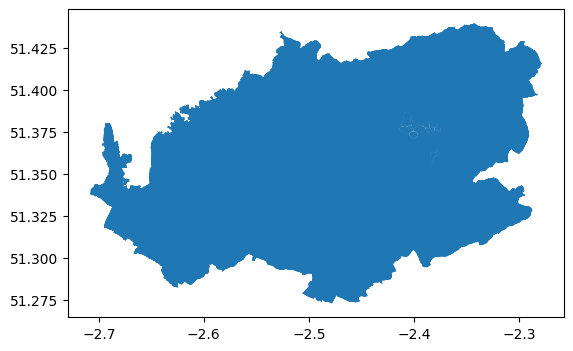

In [85]:
ev_bnes_lsoa.plot()

Fill Missing Data

In [86]:
ev_bnes_lsoa.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 411 entries, 41441 to 101660
Data columns (total 49 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   LSOA11CD    411 non-null    object  
 1   geometry    411 non-null    geometry
 2   LSOA11NM    403 non-null    object  
 3   Fuel        403 non-null    object  
 4   Keepership  403 non-null    object  
 5   2022 Q3     272 non-null    float64 
 6   2022 Q2     266 non-null    float64 
 7   2022 Q1     261 non-null    float64 
 8   2021 Q4     257 non-null    float64 
 9   2021 Q3     249 non-null    float64 
 10  2021 Q2     239 non-null    float64 
 11  2021 Q1     225 non-null    float64 
 12  2020 Q4     212 non-null    float64 
 13  2020 Q3     208 non-null    float64 
 14  2020 Q2     196 non-null    float64 
 15  2020 Q1     196 non-null    float64 
 16  2019 Q4     183 non-null    float64 
 17  2019 Q3     182 non-null    float64 
 18  2019 Q2     173 non-null    float64

In [87]:
ev_bnes_lsoa.Fuel.value_counts()

Battery electric                    107
Plug-in hybrid electric (petrol)    107
Total                               107
Range extended electric              61
Plug-in hybrid electric (diesel)     21
Name: Fuel, dtype: int64

In [88]:
ev_bnes_lsoa[ev_bnes_lsoa.Fuel.isnull()]

,LSOA11CD,geometry,LSOA11NM,Fuel,Keepership,2022 Q3,2022 Q2,2022 Q1,2021 Q4,2021 Q3,...,2014 Q1,2013 Q4,2013 Q3,2013 Q2,2013 Q1,2012 Q4,2012 Q3,2012 Q2,2012 Q1,2011 Q4
41671,E01014431,"POLYGON ((-2.37759 51.36394, -2.37757 51.36383...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41682,E01014435,"POLYGON ((-2.37657 51.37840, -2.37655 51.37838...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41761,E01014458,"POLYGON ((-2.39836 51.37508, -2.39835 51.37508...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41769,E01014461,"POLYGON ((-2.39499 51.37885, -2.39497 51.37884...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41770,E01014462,"POLYGON ((-2.40196 51.37914, -2.40196 51.37914...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41771,E01014463,"POLYGON ((-2.40594 51.38761, -2.40574 51.38753...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41804,E01014473,"POLYGON ((-2.38327 51.37976, -2.38326 51.37976...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41805,E01014474,"POLYGON ((-2.38482 51.38108, -2.38482 51.38104...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [89]:
ev_bnes_lsoa.loc[ev_bnes_lsoa.Fuel.isnull(), 'Fuel']

41671    NaN
41682    NaN
41761    NaN
41769    NaN
41770    NaN
41771    NaN
41804    NaN
41805    NaN
Name: Fuel, dtype: object

BEVs

In [90]:
bev_bnes_lsoa = ev_bnes_lsoa[(ev_bnes_lsoa.Fuel == 'Battery electric') | (ev_bnes_lsoa.Fuel.isnull())]
bev_bnes_lsoa.loc[bev_bnes_lsoa['Fuel'].isnull(), 'Fuel'] = 'Battery electric'

PHEVs

In [91]:
phev_bnes_lsoa = ev_bnes_lsoa[(ev_bnes_lsoa.Fuel == 'Plug-in hybrid electric (petrol)') | (ev_bnes_lsoa.Fuel == 'Plug-in hybrid electric (diesel)') | (ev_bnes_lsoa.Fuel.isnull())]
phev_bnes_lsoa.loc[phev_bnes_lsoa['Fuel'].isnull(), 'Fuel'] = 'Plug-in hybrid electric'

REX

In [92]:
rex_bnes_lsoa = ev_bnes_lsoa[(ev_bnes_lsoa.Fuel == 'Range extended electric') | (ev_bnes_lsoa.Fuel.isnull())]
rex_bnes_lsoa.loc[rex_bnes_lsoa['Fuel'].isnull(),'Fuel'] = 'Range extended electric'

Total

In [93]:
tot_bnes_lsoa = ev_bnes_lsoa[(ev_bnes_lsoa.Fuel == 'Total') | (ev_bnes_lsoa.Fuel.isnull())]
tot_bnes_lsoa.loc[tot_bnes_lsoa['Fuel'].isnull(),'Fuel'] = 'Total'

In [94]:
m5 = folium.Map(location=[loc_lat, loc_lon], tiles='openstreetmap', zoom_start=13)

cp = folium.Choropleth(geo_data = bev_bnes_lsoa,
                       data = bev_bnes_lsoa,
                       columns = ['LSOA11CD', '2022 Q3'],
                       key_on = 'feature.properties.LSOA11CD',
                       fill_color = "YlGn",
                       nan_fill_opacity = 0.5,
                       fill_opacity = 0.7,
                       highlight = True,).add_to(m5)
folium.GeoJsonTooltip(['LSOA11CD', '2022 Q3']).add_to(cp.geojson)
folium.LayerControl().add_to(m5)
m5

In [282]:
test = bev_bnes_lsoa.drop(['geometry', 'LSOA11NM', 'Fuel', 'Keepership'], axis=1).set_index('LSOA11CD').T.iloc[::-1]
test.head()

LSOA11CD,E01014370,E01014371,E01014372,E01014373,E01014374,E01014375,E01014376,E01014377,E01014379,E01014380,...,E01014478,E01014479,E01014480,E01014481,E01014482,E01014483,E01014484,E01033078,E01033079,E01033080
2011 Q4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,NaN,0.0,...,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
2012 Q1,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,NaN,0.0,...,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
2012 Q2,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,NaN,0.0,...,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
2012 Q3,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,NaN,0.0,...,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
2012 Q4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,NaN,0.0,...,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN


In [287]:
test = test.astype('Int64')

In [291]:
import plotly.express as px

fig = px.line(test, x=test.index, y=test.columns)
fig.show()

### Regular Vehicles

In [95]:
v_lsoa = pd.read_csv('../../data/vehicle_data/df_VEH0125.csv')
v_lsoa.head()

/var/folders/3p/gfh9bx_x6g538359fqt4lgtm0000gn/T/ipykernel_4179/1137494342.py:1: DtypeWarning: Columns (5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56) have mixed types. Specify dtype option on import or set low_memory=False.
  v_lsoa = pd.read_csv('../../data/vehicle_data/df_VEH0125.csv')


,LSOA11CD,LSOA11NM,BodyType,Keepership,LicenceStatus,2022 Q3,2022 Q2,2022 Q1,2021 Q4,2021 Q3,...,2012 Q1,2011 Q4,2011 Q3,2011 Q2,2011 Q1,2010 Q4,2010 Q3,2010 Q2,2010 Q1,2009 Q4
0,95AA01S1,Aldergrove 1,Cars,Company,Licensed,423,456,327,353,453,...,[x],[x],[x],[x],[x],[x],[x],[x],[x],[x]
1,95AA01S2,Aldergrove 2,Cars,Company,Licensed,54,53,49,50,52,...,[x],[x],[x],[x],[x],[x],[x],[x],[x],[x]
2,95AA01S3,Aldergrove 3,Cars,Company,Licensed,73,68,69,75,81,...,[x],[x],[x],[x],[x],[x],[x],[x],[x],[x]
3,95AA02W1,Balloo,Cars,Company,Licensed,73,73,72,71,67,...,[x],[x],[x],[x],[x],[x],[x],[x],[x],[x]
4,95AA03W1,Ballycraigy,Cars,Company,Licensed,47,50,54,60,65,...,[x],[x],[x],[x],[x],[x],[x],[x],[x],[x]


In [96]:
v_lsoa = v_lsoa[v_lsoa['BodyType'] == 'Cars']

In [97]:
v_lsoa = v_lsoa[v_lsoa['Keepership'] == 'Private']

In [98]:
v_lsoa = v_lsoa[v_lsoa['LicenceStatus'] == 'Licensed']

In [101]:
v_lsoa = v_lsoa.replace('[c]', np.nan)
v_lsoa = v_lsoa.replace('[x]', np.nan)

In [102]:
cols2 = v_lsoa.columns.drop(['LSOA11CD', 'LSOA11NM', 'BodyType', 'Keepership', 'LicenceStatus'])
v_lsoa[cols2] = v_lsoa[cols2].apply(pd.to_numeric)

Merge with geo Data

In [103]:
v_lsoa_geo = pd.merge(lsoa_geo.loc[:, ['LSOA11CD', 'geometry']], v_lsoa, on='LSOA11CD', how='outer')

Filter for BNES

In [104]:
v_bnes_lsoa = v_lsoa_geo[v_lsoa_geo['LSOA11CD'].isin(lsoa_lookup[lsoa_lookup['LAD22NM'] == 'Bath and North East Somerset'].LSOA11CD)]
v_bnes_lsoa

,LSOA11CD,geometry,LSOA11NM,BodyType,Keepership,LicenceStatus,2022 Q3,2022 Q2,2022 Q1,2021 Q4,...,2012 Q1,2011 Q4,2011 Q3,2011 Q2,2011 Q1,2010 Q4,2010 Q3,2010 Q2,2010 Q1,2009 Q4
13972,E01014370,"POLYGON ((375292.289 165633.714, 375312.807 16...",Bath and North East Somerset 007A,Cars,Private,Licensed,353,357,352,369,...,390.0,397.0,391.0,393.0,384.0,389.0,406.0,378.0,384.0,386.0
13973,E01014371,"POLYGON ((375624.781 165202.406, 375630.812 16...",Bath and North East Somerset 007B,Cars,Private,Licensed,512,507,524,517,...,537.0,552.0,546.0,557.0,552.0,540.0,538.0,549.0,547.0,557.0
13974,E01014372,"POLYGON ((375327.102 165666.338, 375334.541 16...",Bath and North East Somerset 007C,Cars,Private,Licensed,507,506,509,513,...,548.0,553.0,556.0,552.0,571.0,561.0,588.0,604.0,595.0,591.0
13975,E01014373,"POLYGON ((377762.251 168340.474, 377762.747 16...",Bath and North East Somerset 010A,Cars,Private,Licensed,754,770,768,775,...,680.0,674.0,690.0,688.0,695.0,692.0,684.0,696.0,692.0,703.0
13976,E01014374,"POLYGON ((378818.843 167715.550, 378819.000 16...",Bath and North East Somerset 010B,Cars,Private,Licensed,762,759,756,746,...,632.0,627.0,632.0,637.0,634.0,633.0,637.0,628.0,627.0,641.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14082,E01014483,"POLYGON ((375758.523 164571.800, 375762.671 16...",Bath and North East Somerset 012E,Cars,Private,Licensed,445,446,449,453,...,431.0,445.0,458.0,444.0,433.0,438.0,450.0,451.0,449.0,440.0
14083,E01014484,"POLYGON ((374370.605 164766.071, 374379.378 16...",Bath and North East Somerset 012F,Cars,Private,Licensed,405,397,385,392,...,374.0,371.0,366.0,367.0,370.0,361.0,363.0,358.0,361.0,363.0
32406,E01033078,"POLYGON ((377288.000 162662.203, 377299.528 16...",Bath and North East Somerset 010G,Cars,Private,Licensed,1018,1026,1040,1050,...,1021.0,1017.0,1007.0,1004.0,1000.0,998.0,991.0,974.0,981.0,981.0
32407,E01033079,"POLYGON ((376328.490 160543.363, 376327.906 16...",Bath and North East Somerset 010H,Cars,Private,Licensed,707,723,728,734,...,738.0,743.0,743.0,733.0,734.0,725.0,729.0,705.0,705.0,707.0


Change crs

In [105]:
v_bnes_lsoa = v_bnes_lsoa.to_crs('EPSG:4326')

<Axes: >

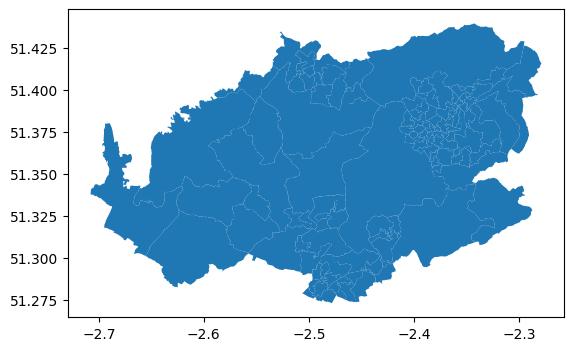

In [106]:
v_bnes_lsoa.plot()

In [107]:
m6 = folium.Map(location=[loc_lat, loc_lon], tiles='openstreetmap', zoom_start=13)

cp = folium.Choropleth(geo_data = v_bnes_lsoa,
                       data = v_bnes_lsoa,
                       columns = ['LSOA11CD', '2022 Q3'],
                       key_on = 'feature.properties.LSOA11CD',
                       fill_color = "YlGn",
                       nan_fill_opacity = 0.5,
                       fill_opacity = 0.7,
                       highlight = True,).add_to(m6)
folium.GeoJsonTooltip(['LSOA11CD', '2022 Q3']).add_to(cp.geojson)
folium.LayerControl().add_to(m6)
m6

### BEV Penetration

In [108]:
bev_bnes_lsoa.head()

,LSOA11CD,geometry,LSOA11NM,Fuel,Keepership,2022 Q3,2022 Q2,2022 Q1,2021 Q4,2021 Q3,...,2014 Q1,2013 Q4,2013 Q3,2013 Q2,2013 Q1,2012 Q4,2012 Q3,2012 Q2,2012 Q1,2011 Q4
41441,E01014370,"POLYGON ((-2.35647 51.38920, -2.35618 51.38913...",Bath and North East Somerset 007A,Battery electric,Private,8.0,7.0,8.0,8.0,6.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41444,E01014371,"POLYGON ((-2.35166 51.38534, -2.35158 51.38530...",Bath and North East Somerset 007B,Battery electric,Private,5.0,5.0,5.0,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41449,E01014372,"POLYGON ((-2.35597 51.38950, -2.35587 51.38942...",Bath and North East Somerset 007C,Battery electric,Private,5.0,5.0,5.0,NaN,5.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41452,E01014373,"POLYGON ((-2.32115 51.41364, -2.32114 51.41364...",Bath and North East Somerset 010A,Battery electric,Private,12.0,11.0,11.0,11.0,9.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41456,E01014374,"POLYGON ((-2.30592 51.40806, -2.30591 51.40806...",Bath and North East Somerset 010B,Battery electric,Private,17.0,18.0,18.0,15.0,15.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [111]:
len(bev_bnes_lsoa)

115

In [109]:
v_bnes_lsoa.head()

,LSOA11CD,geometry,LSOA11NM,BodyType,Keepership,LicenceStatus,2022 Q3,2022 Q2,2022 Q1,2021 Q4,...,2012 Q1,2011 Q4,2011 Q3,2011 Q2,2011 Q1,2010 Q4,2010 Q3,2010 Q2,2010 Q1,2009 Q4
13972,E01014370,"POLYGON ((-2.35647 51.38920, -2.35618 51.38913...",Bath and North East Somerset 007A,Cars,Private,Licensed,353,357,352,369,...,390.0,397.0,391.0,393.0,384.0,389.0,406.0,378.0,384.0,386.0
13973,E01014371,"POLYGON ((-2.35166 51.38534, -2.35158 51.38530...",Bath and North East Somerset 007B,Cars,Private,Licensed,512,507,524,517,...,537.0,552.0,546.0,557.0,552.0,540.0,538.0,549.0,547.0,557.0
13974,E01014372,"POLYGON ((-2.35597 51.38950, -2.35587 51.38942...",Bath and North East Somerset 007C,Cars,Private,Licensed,507,506,509,513,...,548.0,553.0,556.0,552.0,571.0,561.0,588.0,604.0,595.0,591.0
13975,E01014373,"POLYGON ((-2.32115 51.41364, -2.32114 51.41364...",Bath and North East Somerset 010A,Cars,Private,Licensed,754,770,768,775,...,680.0,674.0,690.0,688.0,695.0,692.0,684.0,696.0,692.0,703.0
13976,E01014374,"POLYGON ((-2.30592 51.40806, -2.30591 51.40806...",Bath and North East Somerset 010B,Cars,Private,Licensed,762,759,756,746,...,632.0,627.0,632.0,637.0,634.0,633.0,637.0,628.0,627.0,641.0


In [112]:
len(v_bnes_lsoa)

115

In [119]:
merged_bev_bnes_lsoa = v_bnes_lsoa.merge(bev_bnes_lsoa.drop(['geometry', 'LSOA11NM', 'Keepership'], axis=1), on = 'LSOA11CD', how = 'outer')
merged_bev_bnes_lsoa

,LSOA11CD,geometry,LSOA11NM,BodyType,Keepership,LicenceStatus,2022 Q3_x,2022 Q2_x,2022 Q1_x,2021 Q4_x,...,2014 Q1_y,2013 Q4_y,2013 Q3_y,2013 Q2_y,2013 Q1_y,2012 Q4_y,2012 Q3_y,2012 Q2_y,2012 Q1_y,2011 Q4_y
0,E01014370,"POLYGON ((-2.35647 51.38920, -2.35618 51.38913...",Bath and North East Somerset 007A,Cars,Private,Licensed,353,357,352,369,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,E01014371,"POLYGON ((-2.35166 51.38534, -2.35158 51.38530...",Bath and North East Somerset 007B,Cars,Private,Licensed,512,507,524,517,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,E01014372,"POLYGON ((-2.35597 51.38950, -2.35587 51.38942...",Bath and North East Somerset 007C,Cars,Private,Licensed,507,506,509,513,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,E01014373,"POLYGON ((-2.32115 51.41364, -2.32114 51.41364...",Bath and North East Somerset 010A,Cars,Private,Licensed,754,770,768,775,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,E01014374,"POLYGON ((-2.30592 51.40806, -2.30591 51.40806...",Bath and North East Somerset 010B,Cars,Private,Licensed,762,759,756,746,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110,E01014483,"POLYGON ((-2.34970 51.37967, -2.34964 51.37960...",Bath and North East Somerset 012E,Cars,Private,Licensed,445,446,449,453,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
111,E01014484,"POLYGON ((-2.36965 51.38136, -2.36952 51.38096...",Bath and North East Somerset 012F,Cars,Private,Licensed,405,397,385,392,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
112,E01033078,"POLYGON ((-2.32760 51.36257, -2.32743 51.36222...",Bath and North East Somerset 010G,Cars,Private,Licensed,1018,1026,1040,1050,...,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
113,E01033079,"POLYGON ((-2.34124 51.34348, -2.34125 51.34339...",Bath and North East Somerset 010H,Cars,Private,Licensed,707,723,728,734,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [120]:
merged_bev_bnes_lsoa['bev_pen'] = merged_bev_bnes_lsoa['2022 Q3_y']/merged_bev_bnes_lsoa['2022 Q3_x']

In [122]:
m7 = folium.Map(location=[loc_lat, loc_lon], tiles='openstreetmap', zoom_start=13)

cp = folium.Choropleth(geo_data = merged_bev_bnes_lsoa,
                       data = merged_bev_bnes_lsoa,
                       columns = ['LSOA11CD', 'bev_pen'],
                       key_on = 'feature.properties.LSOA11CD',
                       fill_color = "YlGn",
                       nan_fill_opacity = 0.5,
                       fill_opacity = 0.7,
                       highlight = True,).add_to(m7)
folium.GeoJsonTooltip(['LSOA11CD', 'bev_pen']).add_to(cp.geojson)
folium.LayerControl().add_to(m7)
m7

## LSOA Household counts

In [201]:
house_lsoa = pd.read_csv('../../data/demographic_data/census_2021/LSOA_households.csv')
house_lsoa.head()

,Lower layer Super Output Areas Code,Lower layer Super Output Areas,Observation
0,E01000001,City of London 001A,838
1,E01000002,City of London 001B,824
2,E01000003,City of London 001C,1017
3,E01000005,City of London 001E,480
4,E01000006,Barking and Dagenham 016A,554


In [202]:
house_lsoa = house_lsoa.rename(columns={'Lower layer Super Output Areas Code':'LSOA21CD'})

In [203]:
house_lsoa[house_lsoa['LSOA21CD'].isin(lsoa_lookup[lsoa_lookup['LAD22NM'] == 'Bath and North East Somerset'].LSOA21CD)]

,LSOA21CD,Lower layer Super Output Areas,Observation
13647,E01014370,Bath and North East Somerset 007A,1009
13648,E01014371,Bath and North East Somerset 007B,1044
13649,E01014372,Bath and North East Somerset 007C,1043
13650,E01014373,Bath and North East Somerset 010A,659
13651,E01014374,Bath and North East Somerset 010B,666
...,...,...,...
33200,E01035206,Bath and North East Somerset 002E,590
33201,E01035207,Bath and North East Somerset 013E,846
33202,E01035208,Bath and North East Somerset 013F,612
33203,E01035209,Bath and North East Somerset 022F,401


In [204]:
lsoa_lookup[lsoa_lookup['LAD22NM'] == 'Bath and North East Somerset']

,LSOA11CD,LSOA11NM,LSOA21CD,LSOA21NM,CHGIND,LAD22CD,LAD22NM,LAD22NMW,ObjectId
13651,E01014373,Bath and North East Somerset 010A,E01014373,Bath and North East Somerset 010A,U,E06000022,Bath and North East Somerset,NaN,13652
13652,E01014428,Bath and North East Somerset 008B,E01014428,Bath and North East Somerset 008B,U,E06000022,Bath and North East Somerset,NaN,13653
13676,E01014479,Bath and North East Somerset 005C,E01014479,Bath and North East Somerset 005C,U,E06000022,Bath and North East Somerset,NaN,13677
13678,E01014429,Bath and North East Somerset 008C,E01014429,Bath and North East Somerset 008C,U,E06000022,Bath and North East Somerset,NaN,13679
13681,E01014374,Bath and North East Somerset 010B,E01014374,Bath and North East Somerset 010B,U,E06000022,Bath and North East Somerset,NaN,13682
...,...,...,...,...,...,...,...,...,...
33239,E01014402,Bath and North East Somerset 002A,E01035206,Bath and North East Somerset 002E,S,E06000022,Bath and North East Somerset,NaN,33240
33240,E01014475,Bath and North East Somerset 013C,E01035207,Bath and North East Somerset 013E,S,E06000022,Bath and North East Somerset,NaN,33241
33241,E01014475,Bath and North East Somerset 013C,E01035208,Bath and North East Somerset 013F,S,E06000022,Bath and North East Somerset,NaN,33242
33242,E01014379,Bath and North East Somerset 022A,E01035209,Bath and North East Somerset 022F,S,E06000022,Bath and North East Somerset,NaN,33243


In [206]:
house_lsoa = pd.merge(house_lsoa, lsoa_lookup.loc[:, ['LSOA11CD', 'LSOA21CD']], on = 'LSOA21CD', how='outer')
house_lsoa

,LSOA21CD,Lower layer Super Output Areas,Observation,LSOA11CD
0,E01000001,City of London 001A,838,E01000001
1,E01000002,City of London 001B,824,E01000002
2,E01000003,City of London 001C,1017,E01000003
3,E01000005,City of London 001E,480,E01000005
4,E01000006,Barking and Dagenham 016A,554,E01000006
...,...,...,...,...
35791,W01002036,Vale of Glamorgan 005G,773,W01001126
35792,W01002037,Vale of Glamorgan 005H,565,W01001126
35793,W01002038,Vale of Glamorgan 014G,580,W01001118
35794,W01002039,Vale of Glamorgan 014H,668,W01001118


Merge with lsoa_geo

In [207]:
house_lsoa_geo = pd.merge(lsoa_geo.loc[:, ['LSOA11CD', 'geometry']], house_lsoa, on='LSOA11CD', how='outer')
house_lsoa_geo.head()

,LSOA11CD,geometry,LSOA21CD,Lower layer Super Output Areas,Observation
0,E01000001,"POLYGON ((532151.537 181867.433, 532152.500 18...",E01000001,City of London 001A,838
1,E01000002,"POLYGON ((532634.497 181926.016, 532632.048 18...",E01000002,City of London 001B,824
2,E01000003,"POLYGON ((532153.703 182165.155, 532158.250 18...",E01000003,City of London 001C,1017
3,E01000005,"POLYGON ((533619.062 181402.364, 533639.868 18...",E01000005,City of London 001E,480
4,E01000006,"POLYGON ((545126.852 184310.838, 545145.213 18...",E01000006,Barking and Dagenham 016A,554


Filter for BNES

In [210]:
house_bnes_lsoa = house_lsoa_geo[house_lsoa_geo['LSOA11CD'].isin(lsoa_lookup[lsoa_lookup['LAD22NM'] == 'Bath and North East Somerset'].LSOA11CD)]
house_bnes_lsoa

,LSOA11CD,geometry,LSOA21CD,Lower layer Super Output Areas,Observation
14230,E01014370,"POLYGON ((375292.289 165633.714, 375312.807 16...",E01014370,Bath and North East Somerset 007A,1009
14231,E01014371,"POLYGON ((375624.781 165202.406, 375630.812 16...",E01014371,Bath and North East Somerset 007B,1044
14232,E01014372,"POLYGON ((375327.102 165666.338, 375334.541 16...",E01014372,Bath and North East Somerset 007C,1043
14233,E01014373,"POLYGON ((377762.251 168340.474, 377762.747 16...",E01014373,Bath and North East Somerset 010A,659
14234,E01014374,"POLYGON ((378818.843 167715.550, 378819.000 16...",E01014374,Bath and North East Somerset 010B,666
...,...,...,...,...,...
14343,E01014483,"POLYGON ((375758.523 164571.800, 375762.671 16...",E01014483,Bath and North East Somerset 012E,624
14344,E01014484,"POLYGON ((374370.605 164766.071, 374379.378 16...",E01014484,Bath and North East Somerset 012F,639
33312,E01033078,"POLYGON ((377288.000 162662.203, 377299.528 16...",E01033078,Bath and North East Somerset 010G,688
33313,E01033079,"POLYGON ((376328.490 160543.363, 376327.906 16...",E01033079,Bath and North East Somerset 010H,486


In [211]:
m8 = folium.Map(location=[loc_lat, loc_lon], tiles='openstreetmap', zoom_start=13)

cp = folium.Choropleth(geo_data = house_bnes_lsoa,
                       data = house_bnes_lsoa,
                       columns = ['LSOA11CD', 'Observation'],
                       key_on = 'feature.properties.LSOA11CD',
                       fill_color = "YlGn",
                       nan_fill_opacity = 0.5,
                       fill_opacity = 0.7,
                       highlight = True,).add_to(m8)
folium.GeoJsonTooltip(['LSOA11CD', 'Observation']).add_to(cp.geojson)
folium.LayerControl().add_to(m8)
m8

## Vehicles per Household

In [212]:
house_bnes_lsoa.head()

,LSOA11CD,geometry,LSOA21CD,Lower layer Super Output Areas,Observation
14230,E01014370,"POLYGON ((375292.289 165633.714, 375312.807 16...",E01014370,Bath and North East Somerset 007A,1009
14231,E01014371,"POLYGON ((375624.781 165202.406, 375630.812 16...",E01014371,Bath and North East Somerset 007B,1044
14232,E01014372,"POLYGON ((375327.102 165666.338, 375334.541 16...",E01014372,Bath and North East Somerset 007C,1043
14233,E01014373,"POLYGON ((377762.251 168340.474, 377762.747 16...",E01014373,Bath and North East Somerset 010A,659
14234,E01014374,"POLYGON ((378818.843 167715.550, 378819.000 16...",E01014374,Bath and North East Somerset 010B,666


In [214]:
len(house_bnes_lsoa)

118

In [213]:
v_bnes_lsoa.head()

,LSOA11CD,geometry,LSOA11NM,BodyType,Keepership,LicenceStatus,2022 Q3,2022 Q2,2022 Q1,2021 Q4,...,2012 Q1,2011 Q4,2011 Q3,2011 Q2,2011 Q1,2010 Q4,2010 Q3,2010 Q2,2010 Q1,2009 Q4
13972,E01014370,"POLYGON ((-2.35647 51.38920, -2.35618 51.38913...",Bath and North East Somerset 007A,Cars,Private,Licensed,353,357,352,369,...,390.0,397.0,391.0,393.0,384.0,389.0,406.0,378.0,384.0,386.0
13973,E01014371,"POLYGON ((-2.35166 51.38534, -2.35158 51.38530...",Bath and North East Somerset 007B,Cars,Private,Licensed,512,507,524,517,...,537.0,552.0,546.0,557.0,552.0,540.0,538.0,549.0,547.0,557.0
13974,E01014372,"POLYGON ((-2.35597 51.38950, -2.35587 51.38942...",Bath and North East Somerset 007C,Cars,Private,Licensed,507,506,509,513,...,548.0,553.0,556.0,552.0,571.0,561.0,588.0,604.0,595.0,591.0
13975,E01014373,"POLYGON ((-2.32115 51.41364, -2.32114 51.41364...",Bath and North East Somerset 010A,Cars,Private,Licensed,754,770,768,775,...,680.0,674.0,690.0,688.0,695.0,692.0,684.0,696.0,692.0,703.0
13976,E01014374,"POLYGON ((-2.30592 51.40806, -2.30591 51.40806...",Bath and North East Somerset 010B,Cars,Private,Licensed,762,759,756,746,...,632.0,627.0,632.0,637.0,634.0,633.0,637.0,628.0,627.0,641.0


In [215]:
len(v_bnes_lsoa)

115

In [229]:
merged_v_per_house = pd.merge(house_bnes_lsoa.drop(['geometry', 'LSOA21CD', 'Lower layer Super Output Areas'], axis=1), v_bnes_lsoa, on='LSOA11CD' , how='outer')
merged_v_per_house

,LSOA11CD,Observation,geometry,LSOA11NM,BodyType,Keepership,LicenceStatus,2022 Q3,2022 Q2,2022 Q1,...,2012 Q1,2011 Q4,2011 Q3,2011 Q2,2011 Q1,2010 Q4,2010 Q3,2010 Q2,2010 Q1,2009 Q4
0,E01014370,1009,"POLYGON ((-2.35647 51.38920, -2.35618 51.38913...",Bath and North East Somerset 007A,Cars,Private,Licensed,353,357,352,...,390.0,397.0,391.0,393.0,384.0,389.0,406.0,378.0,384.0,386.0
1,E01014371,1044,"POLYGON ((-2.35166 51.38534, -2.35158 51.38530...",Bath and North East Somerset 007B,Cars,Private,Licensed,512,507,524,...,537.0,552.0,546.0,557.0,552.0,540.0,538.0,549.0,547.0,557.0
2,E01014372,1043,"POLYGON ((-2.35597 51.38950, -2.35587 51.38942...",Bath and North East Somerset 007C,Cars,Private,Licensed,507,506,509,...,548.0,553.0,556.0,552.0,571.0,561.0,588.0,604.0,595.0,591.0
3,E01014373,659,"POLYGON ((-2.32115 51.41364, -2.32114 51.41364...",Bath and North East Somerset 010A,Cars,Private,Licensed,754,770,768,...,680.0,674.0,690.0,688.0,695.0,692.0,684.0,696.0,692.0,703.0
4,E01014374,666,"POLYGON ((-2.30592 51.40806, -2.30591 51.40806...",Bath and North East Somerset 010B,Cars,Private,Licensed,762,759,756,...,632.0,627.0,632.0,637.0,634.0,633.0,637.0,628.0,627.0,641.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,E01014483,624,"POLYGON ((-2.34970 51.37967, -2.34964 51.37960...",Bath and North East Somerset 012E,Cars,Private,Licensed,445,446,449,...,431.0,445.0,458.0,444.0,433.0,438.0,450.0,451.0,449.0,440.0
114,E01014484,639,"POLYGON ((-2.36965 51.38136, -2.36952 51.38096...",Bath and North East Somerset 012F,Cars,Private,Licensed,405,397,385,...,374.0,371.0,366.0,367.0,370.0,361.0,363.0,358.0,361.0,363.0
115,E01033078,688,"POLYGON ((-2.32760 51.36257, -2.32743 51.36222...",Bath and North East Somerset 010G,Cars,Private,Licensed,1018,1026,1040,...,1021.0,1017.0,1007.0,1004.0,1000.0,998.0,991.0,974.0,981.0,981.0
116,E01033079,486,"POLYGON ((-2.34124 51.34348, -2.34125 51.34339...",Bath and North East Somerset 010H,Cars,Private,Licensed,707,723,728,...,738.0,743.0,743.0,733.0,734.0,725.0,729.0,705.0,705.0,707.0


In [230]:
merged_v_per_house['vehicles_per_household'] = merged_v_per_house['2022 Q3']/merged_v_per_house['Observation']
merged_v_per_house['vehicles_per_household']

0      0.349851
1      0.490421
2      0.486098
3      1.144158
4      1.144144
         ...   
113    0.713141
114    0.633803
115    1.479651
116    1.454733
117    0.499136
Name: vehicles_per_household, Length: 118, dtype: float64

In [235]:
merged_v_per_house = gpd.GeoDataFrame(merged_v_per_house, geometry='geometry')

In [236]:
merged_v_per_house.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 118 entries, 0 to 117
Data columns (total 60 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   LSOA11CD                118 non-null    object  
 1   Observation             118 non-null    int64   
 2   geometry                118 non-null    geometry
 3   LSOA11NM                118 non-null    object  
 4   BodyType                118 non-null    object  
 5   Keepership              118 non-null    object  
 6   LicenceStatus           118 non-null    object  
 7   2022 Q3                 118 non-null    int64   
 8   2022 Q2                 118 non-null    int64   
 9   2022 Q1                 118 non-null    int64   
 10  2021 Q4                 118 non-null    int64   
 11  2021 Q3                 118 non-null    int64   
 12  2021 Q2                 118 non-null    int64   
 13  2021 Q1                 118 non-null    float64 
 14  2020 Q4           

In [241]:
m9 = folium.Map(location=[loc_lat, loc_lon], tiles='openstreetmap', zoom_start=13)

cp = folium.Choropleth(geo_data = merged_v_per_house,
                       data = merged_v_per_house,
                       columns = ['LSOA11CD', 'vehicles_per_household'],
                       key_on = 'feature.properties.LSOA11CD',
                       fill_color = "YlGn",
                       nan_fill_opacity = 0.5,
                       fill_opacity = 0.7,
                       highlight = True,).add_to(m9)
folium.GeoJsonTooltip(['LSOA11CD', 'vehicles_per_household']).add_to(cp.geojson)
folium.LayerControl().add_to(m9)
m9

## Vehicle Model analysis

In [ ]:
models_df = pd.read_csv('../../data/vehicle_data/df_VEH0120_UK.csv')
models_df.head()

In [ ]:
models_df.info()

### Filter for Cars only

In [ ]:
models_df = models_df[models_df['BodyType'] == 'Cars']
models_df.head()

In [ ]:
len(models_df)

### Filter for Licenced vehicles only

In [ ]:
models_df = models_df[models_df['LicenceStatus'] == 'Licensed']
models_df.head()

In [ ]:
len(models_df)

### Remove "MISSING" Models

In [ ]:
models_df.Model.value_counts()

In [ ]:
models_df = models_df[models_df.Model != 'MISSING']

In [ ]:
models_df.Model.value_counts()

In [ ]:
len(models_df)

In [ ]:
models_df.sort_values('2022Q3', ascending=False)

In [ ]:
models_2_df = pd.read_csv('../../data/vehicle_data/df_VEH0220.csv', encoding = "ISO-8859-1") # Use encoding = "ISO-8859-1" instead of utf-8
models_2_df.head()

### Filter for Cars only

In [ ]:
models_2_df = models_2_df[models_2_df['BodyType'] == 'Cars']

In [ ]:
models_2_df.Fuel.value_counts()

In [ ]:
models_2_df[models_2_df.Fuel == 'Battery electric'].sort_values('Licensed', ascending=False).head(10)

In [ ]:
models_2_df[models_2_df.Fuel == 'Plug-in hybrid electric (Petrol)'].sort_values('Licensed', ascending=False).head(10)

In [ ]:
models_2_df[models_2_df.Fuel == 'Plug-in hybrid electric (Diesel)'].sort_values('Licensed', ascending=False).head(10)

In [ ]:
models_2_df[models_2_df.Fuel == 'Range extended electric'].sort_values('Licensed', ascending=False).head(10)

In [ ]:
models_2_df[models_2_df.Fuel == 'Battery electric'].sort_values('Licensed', ascending=False).head(50).Model.values

In [ ]:
models_df[models_df.Model.isin(models_2_df[models_2_df.Fuel == 'Battery electric'].sort_values('Licensed', ascending=False).head(50).Model.values)].sort_values('2022Q3', ascending=False)